In [1]:

import keras
from keras.utils import get_file
from keras_retinanet import models

Using TensorFlow backend.


In [2]:
# show images inline
%matplotlib inline

# automatically reload modules when they have changed
%load_ext autoreload
%autoreload 2

# import keras
import keras

# import keras_retinanet
from keras_retinanet import models
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color

# import miscellaneous modules
import matplotlib.pyplot as plt
import cv2
import os
import numpy as np
import time

# set tf backend to allow memory to grow, instead of claiming everything
import tensorflow as tf

def get_session():
    config = tf.ConfigProto()
    config.gpu_options.allow_growth = True
    return tf.Session(config=config)

# use this environment flag to change which GPU to use
#os.environ["CUDA_VISIBLE_DEVICES"] = "1"

# set the modified tf session as backend in keras
keras.backend.tensorflow_backend.set_session(get_session())

In [3]:
# adjust this to point to your downloaded/trained model
# models can be downloaded here: https://github.com/fizyr/keras-retinanet/releases
# model classes are based on coco: http://cocodataset.org/#explore
#or nothing looks like in coco dataset then won't be identifiable: http://cocodataset.org/#explore
# model_path = "/Users/yutakahosoai/project/data/keras-retinanet/snapshots/resnet50_coco_best_v2.1.0.h5"
# model_path = "/Users/yutakahosoai/project/data/satellite/jellyfish.h5"
# model_path = "/Users/yutakahosoai/project/data/object_detection/jellyfish_epoch10_itr1500.h5"
model_path = "/Users/yutakahosoai/project/data/object_detection/debris_090818.h5"


# load retinanet model
model = models.load_model(model_path, backbone_name='resnet50')

# if the model is not converted to an inference model, use the line below
# see: https://github.com/fizyr/keras-retinanet#converting-a-training-model-to-inference-model
#model = models.load_model(model_path, backbone_name='resnet50', convert=True)

# print(model.summary())

# load label to names mapping for visualization purposes
# labels_to_names = {1:"JellyFish"}
# labels_to_names = {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted plant', 59: 'bed', 60: 'dining table', 61: 'toilet', 62: 'tv', 63: 'laptop', 64: 'mouse', 65: 'remote', 66: 'keyboard', 67: 'cell phone', 68: 'microwave', 69: 'oven', 70: 'toaster', 71: 'sink', 72: 'refrigerator', 73: 'book', 74: 'clock', 75: 'vase', 76: 'scissors', 77: 'teddy bear', 78: 'hair drier', 79: 'toothbrush'}

labels_to_names = {0: 'Bicycle', 1: 'Boat', 2: 'Surfboard', 3: 'Bottle', 4: 'Plastic bag', 5: 'Wheel', 6: 'Tire'}
#                    , 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted plant', 59: 'bed', 60: 'dining table', 61: 'toilet', 62: 'tv', 63: 'laptop', 64: 'mouse', 65: 'remote', 66: 'keyboard', 67: 'cell phone', 68: 'microwave', 69: 'oven', 70: 'toaster', 71: 'sink', 72: 'refrigerator', 73: 'book', 74: 'clock', 75: 'vase', 76: 'scissors', 77: 'teddy bear', 78: 'hair drier', 79: 'toothbrush'}

# Bicycle,0
# Boat,1
# Surfboard,2
# Bottle,3
# Plastic bag,4
# Wheel,5
# Tire,6

/Users/yutakahosoai/anaconda/envs/py36/lib/python3.6/site-packages/keras/engine/saving.py:269: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


In [ ]:
def display_objects(image_file):
    image = read_image_bgr(image_file)

    # copy to draw on
    draw = image.copy()
    draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(120, 120))

    # preprocess image for network
    image = preprocess_image(image)
    # image, scale = resize_image(image)

    # process image
    start = time.time()
    boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
    print("processing time: ", time.time() - start)
    for box, score, label in zip(boxes[0], scores[0], labels[0]):
        # scores are sorted so we can break
        if score < 0.2:
            print("not enough confidence")
            break
        
            
        color = label_color(label)
        print(box)
        b = box.astype(int)
        draw_box(draw, b, color=color)
        if score > 0.4:
            caption = "{} {:.3f}".format(labels_to_names[label], score)
            print(caption)
        else:
            caption = ""
        draw_caption(draw, b, caption)
        break
    plt.figure(figsize=(120, 120))

    plt.imshow(draw)
    plt.show()
# correct for image scale
# boxes /= scale
display_objects('/Users/yutakahosoai/project/data/object_detection/sample_images/tire1.jpg')

processing time:  11.492550134658813
Boat 0.517
not enough confidence


<Figure size 8640x8640 with 0 Axes>

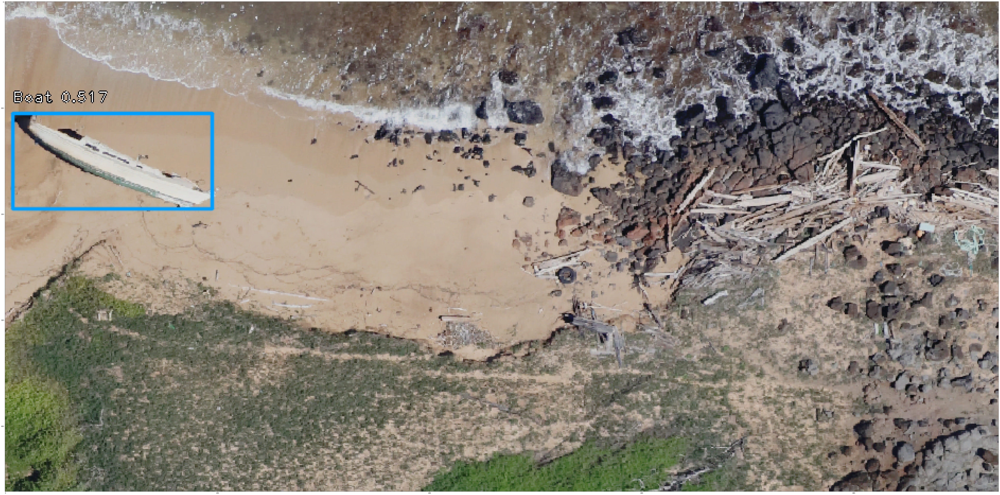

In [6]:
display_objects('/Users/yutakahosoai/project/data/aerial/debris/with_vessel.png')

processing time:  4.344125270843506
Surfboard 0.318
not enough confidence


<Figure size 8640x8640 with 0 Axes>

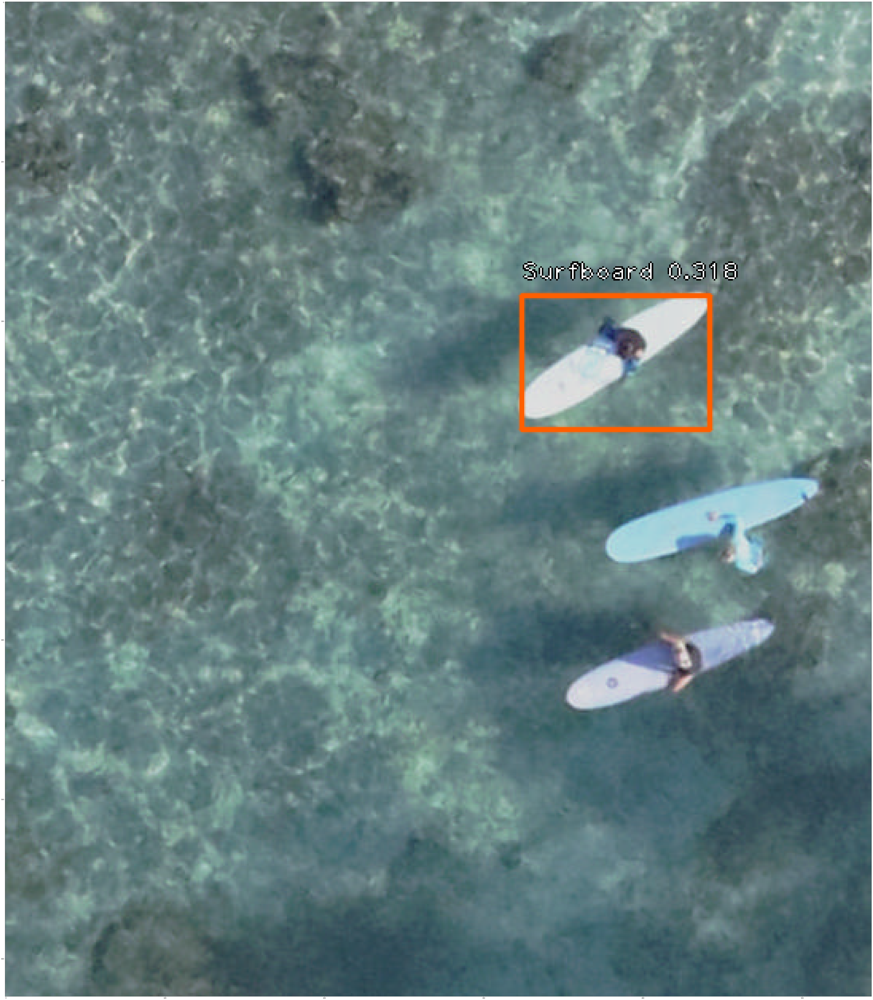

In [12]:
display_objects('/Users/yutakahosoai/project/data/object_detection/sample_images/surfers/aerial_surfers.png')

processing time:  4.479952335357666
Boat 0.226
not enough confidence


<Figure size 8640x8640 with 0 Axes>

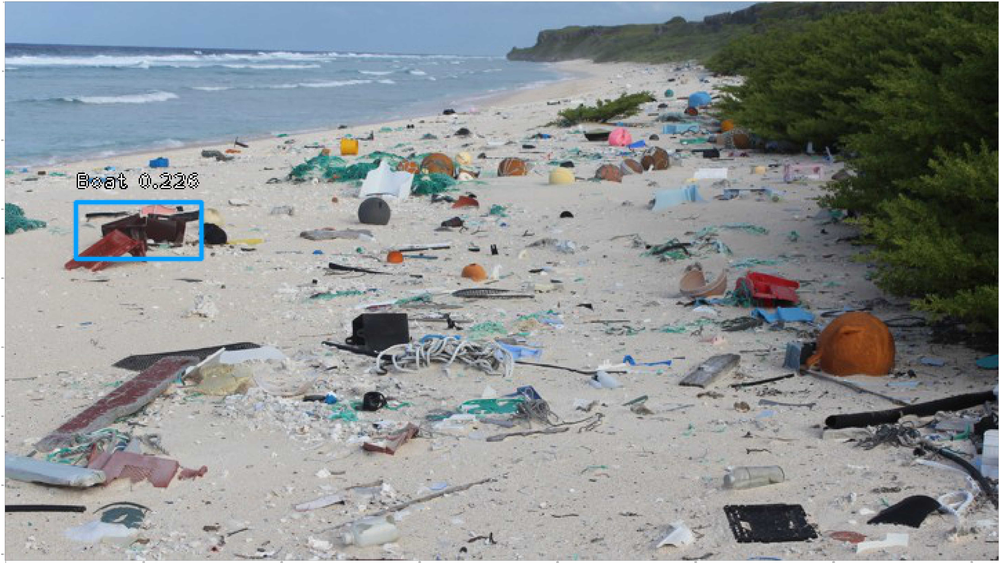

In [13]:
display_objects('/Users/yutakahosoai/project/data/object_detection/sample_images/junks_street_view.jpg')

processing time:  78.07771325111389
Wheel 0.388
Tire 0.297
Boat 0.273
Surfboard 0.261
not enough confidence


<Figure size 8640x8640 with 0 Axes>

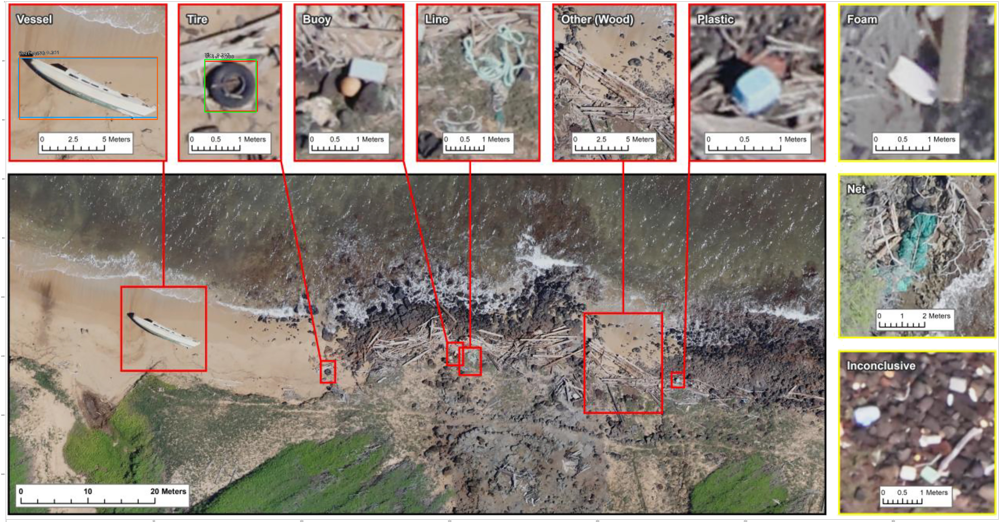

In [15]:
display_objects('/Users/yutakahosoai/project/data/object_detection/sample_images/from_article.jpg')

processing time:  36.60697603225708
Boat 0.430
Boat 0.351
Boat 0.263
Boat 0.215
Wheel 0.177
Wheel 0.137
Surfboard 0.128
Tire 0.115
not enough confidence


<Figure size 8640x8640 with 0 Axes>

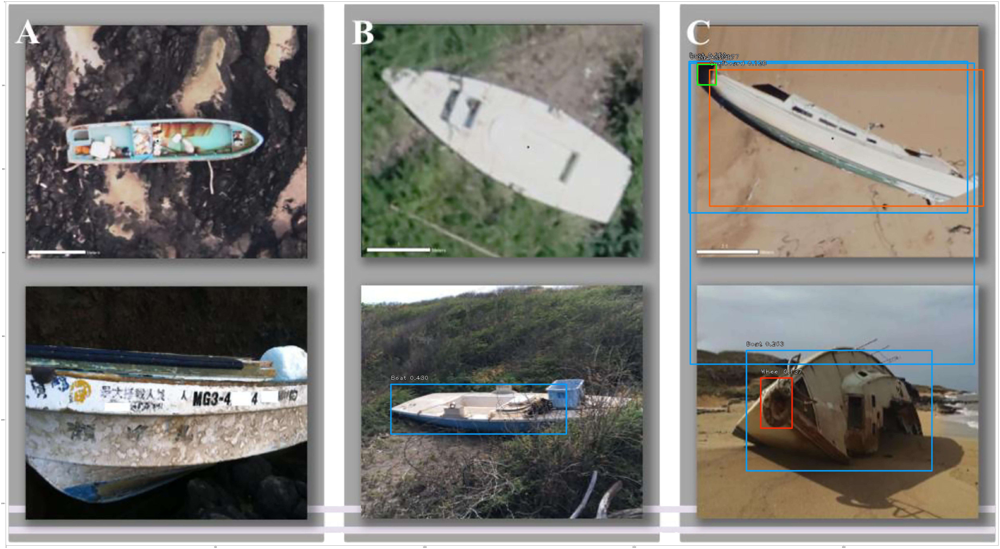

In [9]:
display_objects('/Users/yutakahosoai/project/data/object_detection/sample_images/boats.jpg')

processing time:  2.952237129211426
Wheel 0.161
Tire 0.126
Bicycle 0.119
not enough confidence


<Figure size 8640x8640 with 0 Axes>

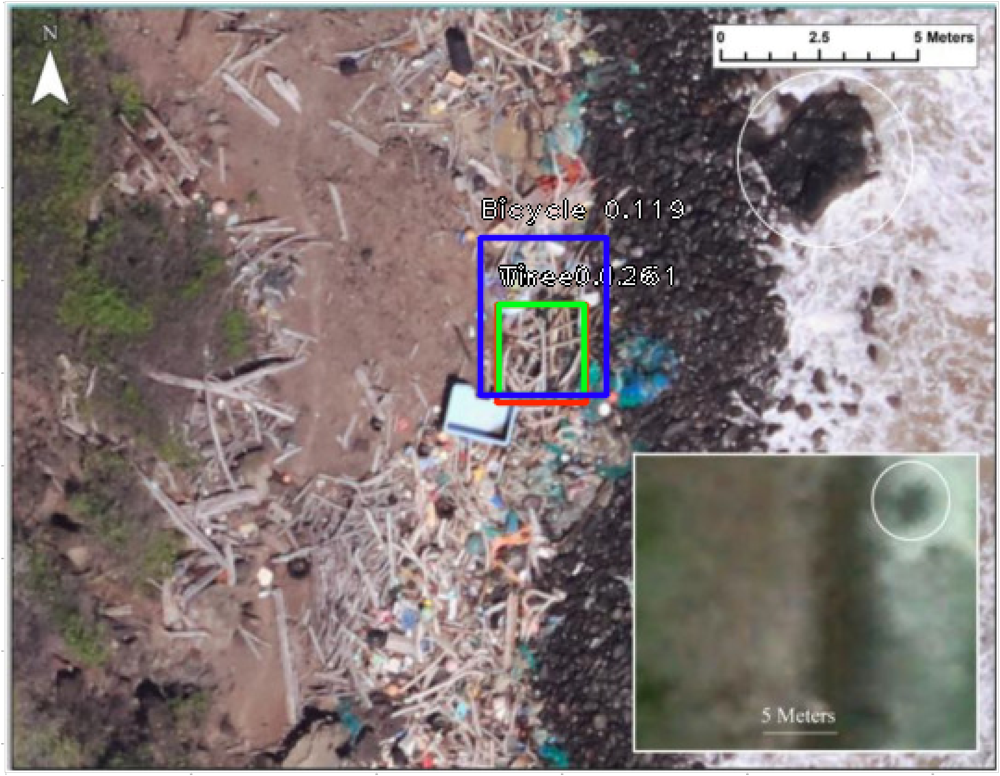

In [10]:
display_objects('/Users/yutakahosoai/project/data/object_detection/sample_images/small_tires.jpg')

In [10]:
scores

array([[ 0.21813163,  0.14523226,  0.13147949,  0.12265808,  0.10204241,
         0.09934891,  0.09484907,  0.09260339,  0.09085324,  0.09011143,
         0.08887613,  0.08742429,  0.08535109,  0.08438859,  0.08288268,
         0.08093387,  0.07907665,  0.07903464,  0.07728866,  0.07562276,
         0.07431991,  0.07176072,  0.07142432,  0.07079603,  0.07045766,
         0.06910136,  0.06900818,  0.06888534,  0.0683226 ,  0.06805784,
         0.06712693,  0.06652325,  0.06464878,  0.06305149,  0.0622734 ,
         0.06166844,  0.06163994,  0.06139323,  0.05905712,  0.05904125,
         0.05892428,  0.05851379,  0.05847716,  0.05755173,  0.05736574,
         0.05631551,  0.05623638,  0.0558266 ,  0.05560582,  0.05494341,
         0.05493543,  0.05471377,  0.05403987,  0.05382412,  0.0528813 ,
         0.05281753,  0.05280696,  0.05275242,  0.05221559,  0.05196291,
         0.05140918,  0.05138204,  0.05131987,  0.05069961,  0.05060419,
         0.05045513, -1.        , -1.        , -1. 

car 0.218
car 0.145
car 0.131
bottle 0.123
clock 0.102
not enough confidence


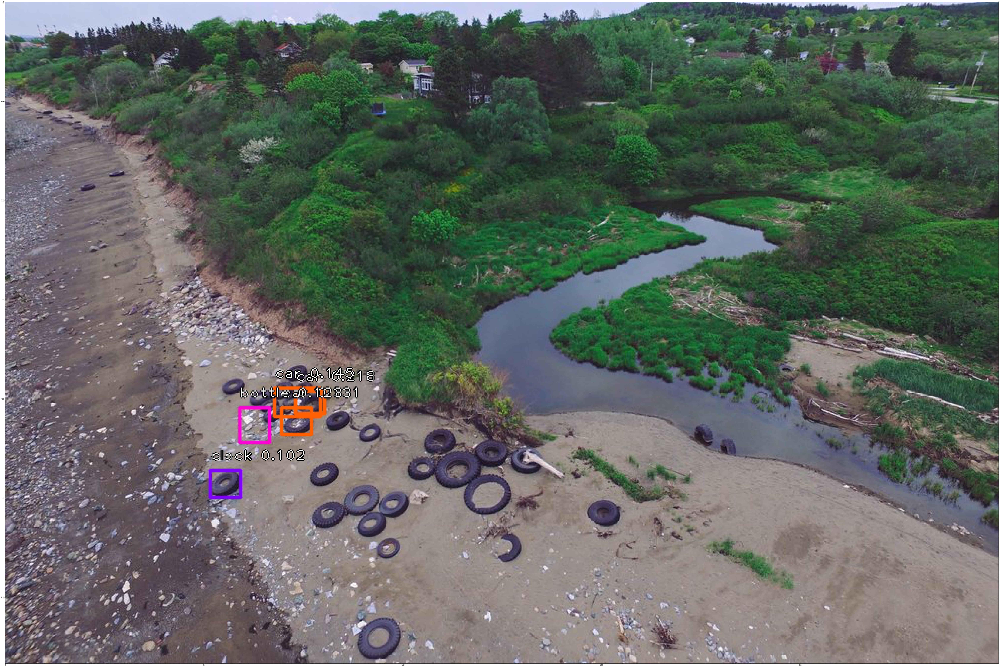

In [15]:
display_objects('/Users/yutakahosoai/project/data/object_detection/sample_images/tires.jpg')
# visualize detections
